In [1]:
# install dependencies: 
!pip install pyyaml==5.1 'pycocotools>=2.0.1'
!pip install torch==1.6.0+cu101 torchvision==0.7.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 8.1MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44091 sha256=5de617e043ba7e6a219b80f3eb299967b2f61e42be0955d114b09bc2ae5097b5
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 708.0MB 25kB/s 
     |████████████████████████████████| 5.9MB 30.3MB/s 
ERROR: torchtext 0.10.0 has requirement torch==1.9.0, but you'll have torch 1.6.0+cu101 which is incompatible.
  Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Succes

In [ ]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.6)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.6")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
%cd '/content/gdrive/My Drive/Dhaka'

/content/gdrive/My Drive/Dhaka


In [ ]:
import pandas as pd 
df = pd.read_csv('images/train_labels.csv')
df

,filename,width,height,class,xmin,ymin,xmax,ymax
0,Dipto_ 111.jpg,1913,891,truck,7,327,350,804
1,Dipto_ 111.jpg,1913,891,truck,846,304,1067,671
2,Dipto_ 111.jpg,1913,891,truck,1316,396,1909,727
3,Dipto_ 111.jpg,1913,891,truck,697,455,852,641
4,Dipto_ 111.jpg,1913,891,three wheelers (CNG),326,502,689,847
...,...,...,...,...,...,...,...,...
13856,Dipto_ 42.jpg,1920,1080,bus,1070,214,1106,246
13857,Dipto_ 42.jpg,1920,1080,three wheelers (CNG),1003,256,1020,274
13858,Dipto_ 42.jpg,1920,1080,bus,1687,141,1920,431
13859,Dipto_ 43.jpg,1920,1080,motorbike,377,494,1713,1080


In [ ]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode
import itertools
import cv2
import pandas as pd
df
# write a function that loads the dataset into detectron2's standard format
def get_car_dicts(csv_file, img_dir):
    df = pd.read_csv(csv_file)
    df['filename'] = df['filename'].map(lambda x: img_dir+x)
    print(df['filename']) 
    classes = ['ambulance', 'auto rickshaw', 'bicycle', 'bus', 'car', 'garbagevan', 'human hauler', 'minibus', 'minivan', 'motorbike', 'pickup', 'army vehicle', 'policecar', 'rickshaw', 'scooter', 'suv', 'taxi', 'three wheelers (CNG)', 'truck', 'van', 'wheelbarrow']

    df['class_int'] = df['class'].map(lambda x: classes.index(x))
    print(df['class_int']) 
    dataset_dicts = []
    for filename in df['filename'].unique().tolist():
        print(filename)
        record = {}
        
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["height"] = height
        record["width"] = width

        objs = []
        for index, row in df[(df['filename']==filename)].iterrows():
          obj= {
              'bbox': [row['xmin'], row['ymin'], row['xmax'], row['ymax']],
              'bbox_mode': BoxMode.XYXY_ABS,
              'category_id': row['class_int'],
              "iscrowd": 0
          }
          objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [ ]:
get_car_dicts('/content/gdrive/My Drive/Dhaka/images/train_labels.csv', 'images/train/')

0        images/train/Dipto_ 111.jpg
1        images/train/Dipto_ 111.jpg
2        images/train/Dipto_ 111.jpg
3        images/train/Dipto_ 111.jpg
4        images/train/Dipto_ 111.jpg
                    ...             
13856     images/train/Dipto_ 42.jpg
13857     images/train/Dipto_ 42.jpg
13858     images/train/Dipto_ 42.jpg
13859     images/train/Dipto_ 43.jpg
13860     images/train/Dipto_ 43.jpg
Name: filename, Length: 13861, dtype: object
0        18
1        18
2        18
3        18
4        17
         ..
13856     3
13857    17
13858     3
13859     9
13860     9
Name: class_int, Length: 13861, dtype: int64
images/train/Dipto_ 111.jpg
images/train/Dipto_ 112.jpg
images/train/Dipto_ 113.jpg
images/train/Dipto_ 114.jpg
images/train/Dipto_ 115.jpg
images/train/Dipto_ 116.jpg
images/train/Dipto_ 117.jpg
images/train/Dipto_ 118.jpg
images/train/Dipto_ 119.jpg
images/train/Dipto_ 120.jpg
images/train/Dipto_ 121.jpg
images/train/Dipto_ 122.jpg
images/train/Dipto_ 123.jpg
images/

[{'annotations': [{'bbox': [7, 327, 350, 804],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 18,
    'iscrowd': 0},
   {'bbox': [846, 304, 1067, 671],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 18,
    'iscrowd': 0},
   {'bbox': [1316, 396, 1909, 727],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 18,
    'iscrowd': 0},
   {'bbox': [697, 455, 852, 641],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 18,
    'iscrowd': 0},
   {'bbox': [326, 502, 689, 847],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 17,
    'iscrowd': 0},
   {'bbox': [1149, 537, 1214, 607],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 18,
    'iscrowd': 0},
   {'bbox': [1075, 537, 1150, 607],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 18,
    'iscrowd': 0}],
  'file_name': 'images/train/Dipto_ 111.jpg',
  'height': 891,
  'width': 1913},
 {'annotations': [{'bbox': [737, 120, 1139, 717],
    'bbox_mode': <BoxMode.XYXY_ABS: 

In [ ]:
## Took the validation dataseta and seperated them from train 

In [ ]:
get_car_dicts('/content/gdrive/My Drive/Dhaka/images/test_labels.csv', 'images/train/')

0      images/train/Dipto_ 44.jpg
1      images/train/Dipto_ 44.jpg
2      images/train/Dipto_ 44.jpg
3      images/train/Dipto_ 44.jpg
4      images/train/Dipto_ 44.jpg
                  ...            
350    images/train/Dipto_ 99.jpg
351    images/train/Dipto_ 99.jpg
352    images/train/Dipto_ 99.jpg
353    images/train/Dipto_ 99.jpg
354    images/train/Dipto_ 99.jpg
Name: filename, Length: 355, dtype: object
0       9
1       9
2       9
3      19
4      17
       ..
350     4
351    10
352    10
353    18
354    18
Name: class_int, Length: 355, dtype: int64
images/train/Dipto_ 44.jpg
images/train/Dipto_ 45.jpg
images/train/Dipto_ 46.jpg
images/train/Dipto_ 47.jpg
images/train/Dipto_ 48.jpg
images/train/Dipto_ 49.jpg
images/train/Dipto_ 50.jpg
images/train/Dipto_ 51.jpg
images/train/Dipto_ 52.jpg
images/train/Dipto_ 53.jpg
images/train/Dipto_ 54.jpg
images/train/Dipto_ 55.jpg
images/train/Dipto_ 56.jpg
images/train/Dipto_ 57.jpg
images/train/Dipto_ 58.jpg
images/train/Dipto_ 59.jp

[{'annotations': [{'bbox': [348, 563, 1722, 1080],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 9,
    'iscrowd': 0},
   {'bbox': [733, 284, 768, 332],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 9,
    'iscrowd': 0},
   {'bbox': [709, 283, 738, 330],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 9,
    'iscrowd': 0},
   {'bbox': [1113, 258, 1380, 344],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 19,
    'iscrowd': 0},
   {'bbox': [1038, 279, 1089, 317],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 17,
    'iscrowd': 0},
   {'bbox': [819, 278, 889, 310],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 8,
    'iscrowd': 0},
   {'bbox': [433, 286, 544, 383],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 15,
    'iscrowd': 0},
   {'bbox': [530, 288, 566, 350],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'category_id': 17,
    'iscrowd': 0},
   {'bbox': [216, 311, 303, 396],
    'bbox_mode': <Box

In [ ]:

from detectron2.data import DatasetCatalog, MetadataCatalog

classes = ['ambulance', 'auto rickshaw', 'bicycle', 'bus', 'car', 'garbagevan', 'human hauler', 'minibus', 'minivan', 'motorbike', 'pickup', 'army vehicle', 'policecar', 'rickshaw', 'scooter', 'suv', 'taxi', 'three wheelers (CNG)', 'truck', 'van', 'wheelbarrow']

for d in ["train"]:
    DatasetCatalog.register('images_' + d, lambda d=d: get_car_dicts('images/' + d + '_labels.csv', 'images/' + d+'/'))
    MetadataCatalog.get('images_' + d).set(thing_classes=classes)
car_metadata = MetadataCatalog.get('images_train')
print(car_metadata)
print(DatasetCatalog.register)

Metadata(name='images_train', thing_classes=['ambulance', 'auto rickshaw', 'bicycle', 'bus', 'car', 'garbagevan', 'human hauler', 'minibus', 'minivan', 'motorbike', 'pickup', 'army vehicle', 'policecar', 'rickshaw', 'scooter', 'suv', 'taxi', 'three wheelers (CNG)', 'truck', 'van', 'wheelbarrow'])
<bound method _DatasetCatalog.register of DatasetCatalog(registered datasets: coco_2014_train, coco_2014_val, coco_2014_minival, coco_2014_minival_100, coco_2014_valminusminival, coco_2017_train, coco_2017_val, coco_2017_test, coco_2017_test-dev, coco_2017_val_100, keypoints_coco_2014_train, keypoints_coco_2014_val, keypoints_coco_2014_minival, keypoints_coco_2014_valminusminival, keypoints_coco_2014_minival_100, keypoints_coco_2017_train, keypoints_coco_2017_val, keypoints_coco_2017_val_100, coco_2017_train_panoptic_separated, coco_2017_train_panoptic_stuffonly, coco_2017_train_panoptic, coco_2017_val_panoptic_separated, coco_2017_val_panoptic_stuffonly, coco_2017_val_panoptic, coco_2017_val_

0        images/train/Dipto_ 111.jpg
1        images/train/Dipto_ 111.jpg
2        images/train/Dipto_ 111.jpg
3        images/train/Dipto_ 111.jpg
4        images/train/Dipto_ 111.jpg
                    ...             
13856     images/train/Dipto_ 42.jpg
13857     images/train/Dipto_ 42.jpg
13858     images/train/Dipto_ 42.jpg
13859     images/train/Dipto_ 43.jpg
13860     images/train/Dipto_ 43.jpg
Name: filename, Length: 13861, dtype: object
0        18
1        18
2        18
3        18
4        17
         ..
13856     3
13857    17
13858     3
13859     9
13860     9
Name: class_int, Length: 13861, dtype: int64
images/train/Dipto_ 111.jpg
images/train/Dipto_ 112.jpg
images/train/Dipto_ 113.jpg
images/train/Dipto_ 114.jpg
images/train/Dipto_ 115.jpg
images/train/Dipto_ 116.jpg
images/train/Dipto_ 117.jpg
images/train/Dipto_ 118.jpg
images/train/Dipto_ 119.jpg
images/train/Dipto_ 120.jpg
images/train/Dipto_ 121.jpg
images/train/Dipto_ 122.jpg
images/train/Dipto_ 123.jpg
images/

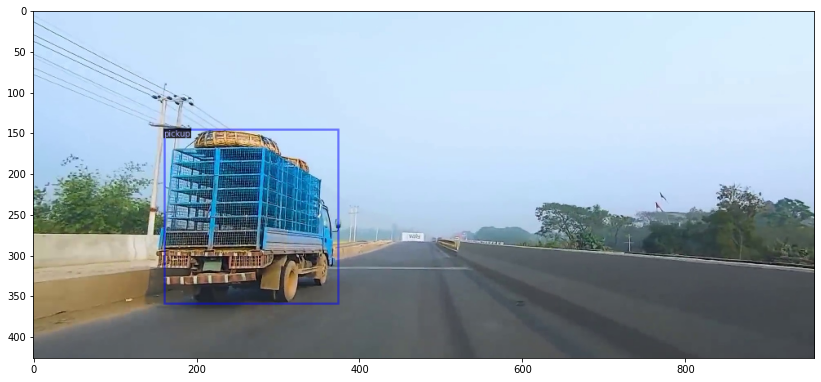

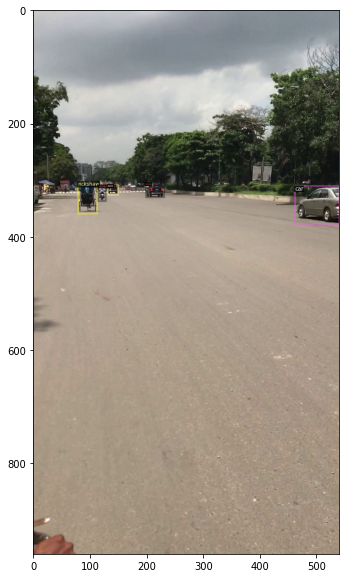

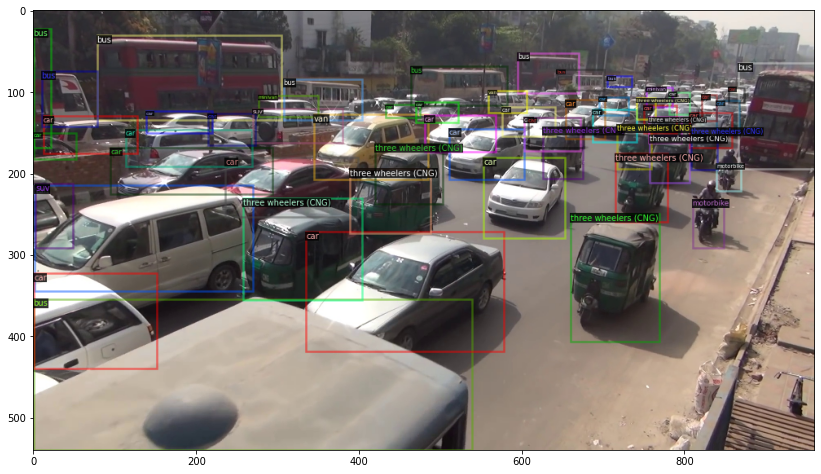

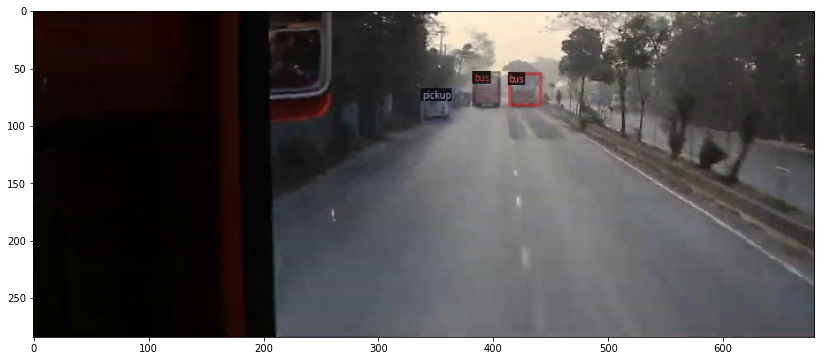

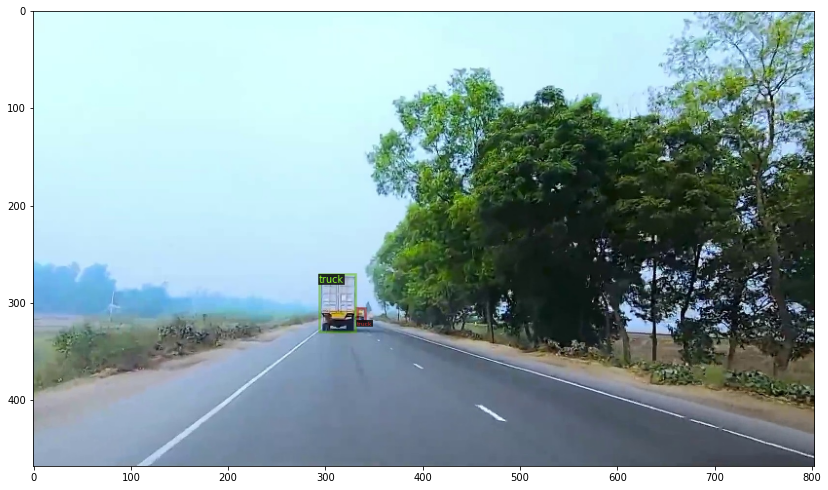

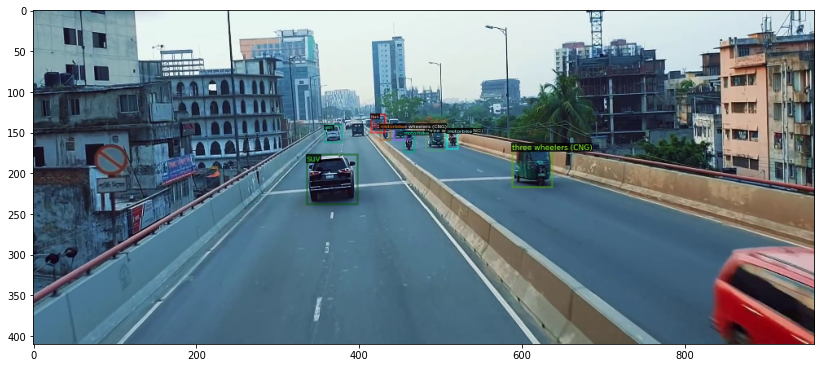

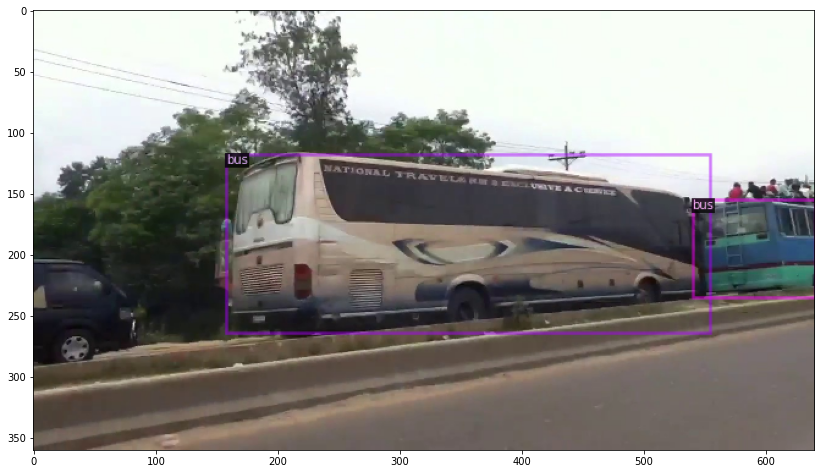

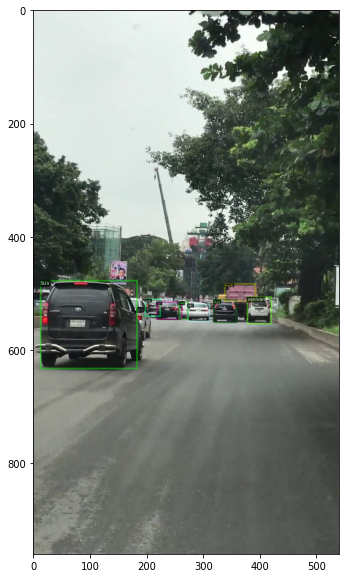

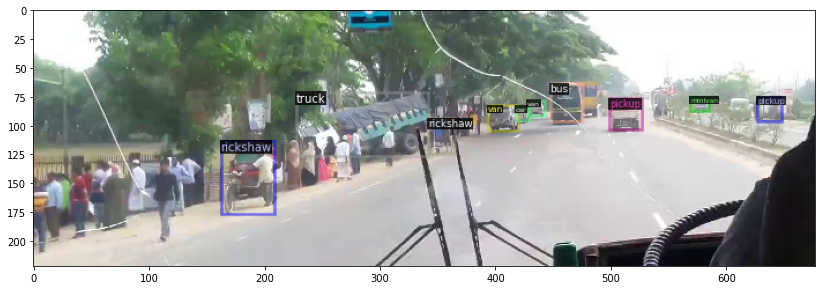

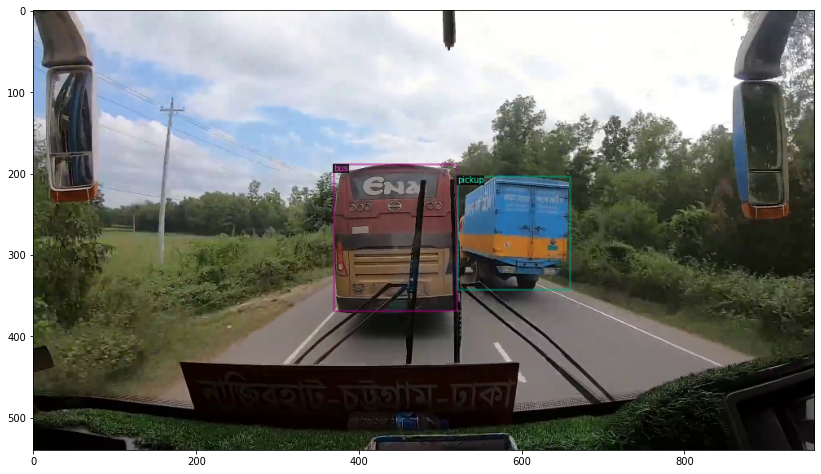

In [ ]:
import pandas as pd
import random
from detectron2.utils.visualizer import Visualizer
%matplotlib inline
from matplotlib import pyplot as plt

dataset_dicts = DatasetCatalog.get('images_train')
for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    v = Visualizer(img[:, :, ::-1], metadata=car_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()


In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ('images_train',)
cfg.DATASETS.TEST = ()   
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.MAX_ITER = 1009
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 21

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[01/18 10:25:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (22, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (22,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (84, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (84,) in the model! You might want to double check if this is expected.


[01/18 10:26:57 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  num_fg = fg_inds.nonzero().numel()


[01/18 10:27:07 d2.utils.events]:  eta: 0:07:51  iter: 19  total_loss: 3.194  loss_cls: 2.587  loss_box_reg: 0.4552  loss_rpn_cls: 0.03929  loss_rpn_loc: 0.05702  time: 0.4781  data_time: 0.0578  lr: 0.00039962  max_mem: 3677M
[01/18 10:27:16 d2.utils.events]:  eta: 0:07:36  iter: 39  total_loss: 1.502  loss_cls: 0.8029  loss_box_reg: 0.5316  loss_rpn_cls: 0.0341  loss_rpn_loc: 0.02556  time: 0.4729  data_time: 0.0493  lr: 0.00079922  max_mem: 3677M
[01/18 10:27:26 d2.utils.events]:  eta: 0:07:23  iter: 59  total_loss: 1.154  loss_cls: 0.5754  loss_box_reg: 0.462  loss_rpn_cls: 0.0221  loss_rpn_loc: 0.03219  time: 0.4722  data_time: 0.0364  lr: 0.0011988  max_mem: 3786M
[01/18 10:27:35 d2.utils.events]:  eta: 0:07:17  iter: 79  total_loss: 1.03  loss_cls: 0.514  loss_box_reg: 0.4928  loss_rpn_cls: 0.01683  loss_rpn_loc: 0.03365  time: 0.4723  data_time: 0.0288  lr: 0.0015984  max_mem: 3786M
[01/18 10:27:45 d2.utils.events]:  eta: 0:07:11  iter: 99  total_loss: 1.117  loss_cls: 0.5542  

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ('images_train', )
cfg.TEST.EVAL_PERIOD = 200
predictor = DefaultPredictor(cfg)

In [ ]:
df_test = pd.read_csv('images/test_labels.csv')
df_test

,filename,width,height,class,xmin,ymin,xmax,ymax
0,Dipto_ 44.jpg,1920,1080,motorbike,348,563,1722,1080
1,Dipto_ 44.jpg,1920,1080,motorbike,733,284,768,332
2,Dipto_ 44.jpg,1920,1080,motorbike,709,283,738,330
3,Dipto_ 44.jpg,1920,1080,van,1113,258,1380,344
4,Dipto_ 44.jpg,1920,1080,three wheelers (CNG),1038,279,1089,317
...,...,...,...,...,...,...,...,...
350,Dipto_ 99.jpg,1905,869,car,395,477,450,520
351,Dipto_ 99.jpg,1905,869,pickup,775,417,882,503
352,Dipto_ 99.jpg,1905,869,pickup,544,389,668,517
353,Dipto_ 99.jpg,1905,869,truck,473,458,500,482


In [ ]:
from detectron2.utils.visualizer import ColorMode
import random

dataset_dicts = DatasetCatalog.get('images_train')
for d in dataset_dicts: 
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    print(outputs)
    

0        images/train/Dipto_ 111.jpg
1        images/train/Dipto_ 111.jpg
2        images/train/Dipto_ 111.jpg
3        images/train/Dipto_ 111.jpg
4        images/train/Dipto_ 111.jpg
                    ...             
13856     images/train/Dipto_ 42.jpg
13857     images/train/Dipto_ 42.jpg
13858     images/train/Dipto_ 42.jpg
13859     images/train/Dipto_ 43.jpg
13860     images/train/Dipto_ 43.jpg
Name: filename, Length: 13861, dtype: object
0        18
1        18
2        18
3        18
4        17
         ..
13856     3
13857    17
13858     3
13859     9
13860     9
Name: class_int, Length: 13861, dtype: int64
images/train/Dipto_ 111.jpg
images/train/Dipto_ 112.jpg
images/train/Dipto_ 113.jpg
images/train/Dipto_ 114.jpg
images/train/Dipto_ 115.jpg
images/train/Dipto_ 116.jpg
images/train/Dipto_ 117.jpg
images/train/Dipto_ 118.jpg
images/train/Dipto_ 119.jpg
images/train/Dipto_ 120.jpg
images/train/Dipto_ 121.jpg
images/train/Dipto_ 122.jpg
images/train/Dipto_ 123.jpg
images/

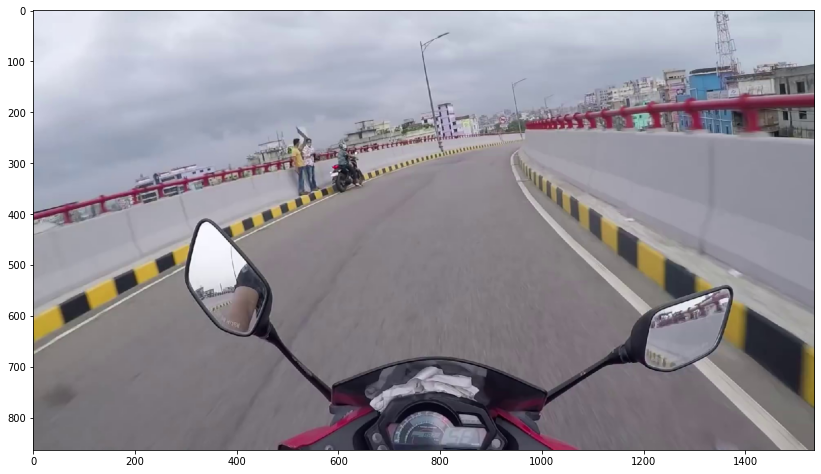

In [ ]:
    v = Visualizer(im[:, :, ::-1], metadata=car_metadata, scale=0.8)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

/content/gdrive/My Drive/Dhaka/images/test/sabiha(248)_jpg.rf.63fb54b5dd5fb81c469a17cad22cd222.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


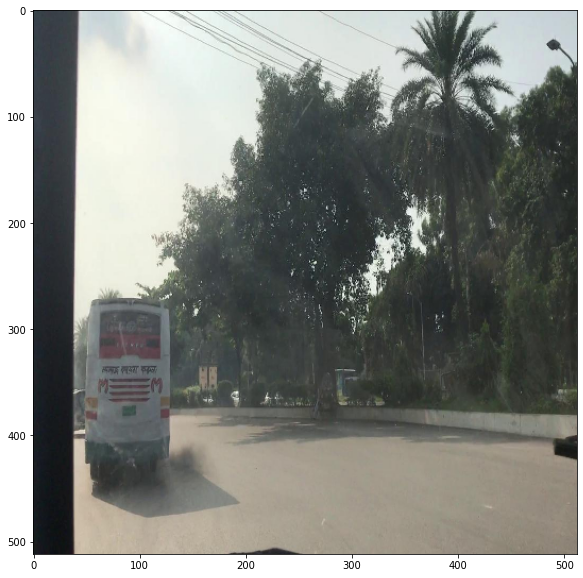

/content/gdrive/My Drive/Dhaka/images/test/Asraf_51_jpg.rf.0e3516baf7509bc2c4a4aa8deea494c2.jpg
{'instances': Instances(num_instances=2, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[701.9903, 761.5790, 748.2252, 800.4150],
        [ 57.6748, 498.4785, 136.6923, 547.2529]], device='cuda:0')), scores: tensor([0.7037, 0.5038], device='cuda:0'), pred_classes: tensor([4, 4], device='cuda:0')])}


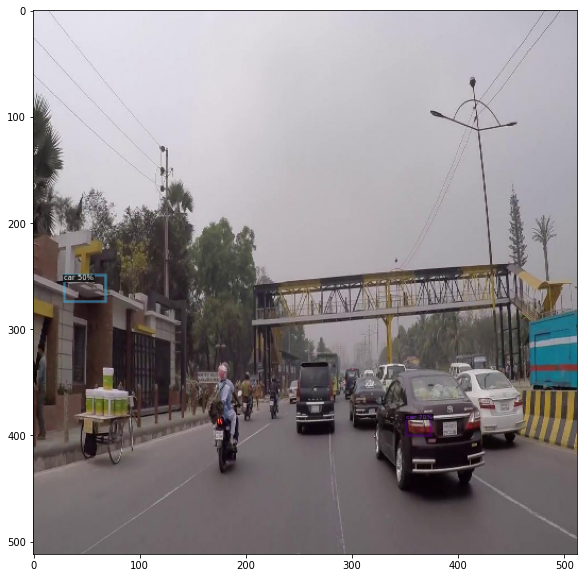

/content/gdrive/My Drive/Dhaka/images/test/sabiha(174)_jpg.rf.77fd8fb06ccbe24a209d744aa900e01f.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


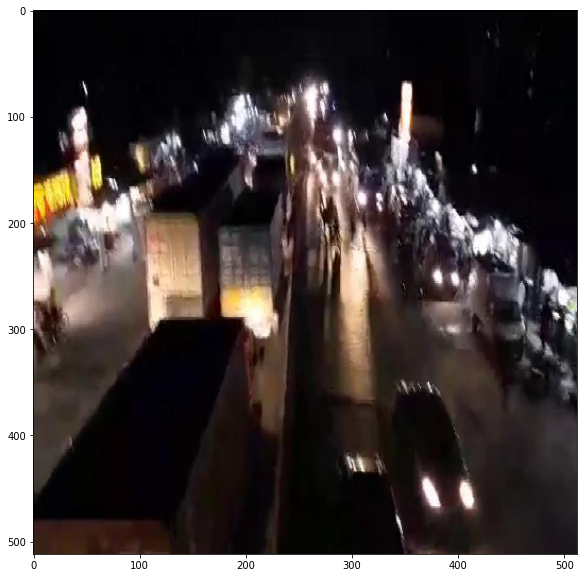

/content/gdrive/My Drive/Dhaka/images/test/sabiha(161)_jpg.rf.5e94438889601ee2427a8d7a7cde4f53.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


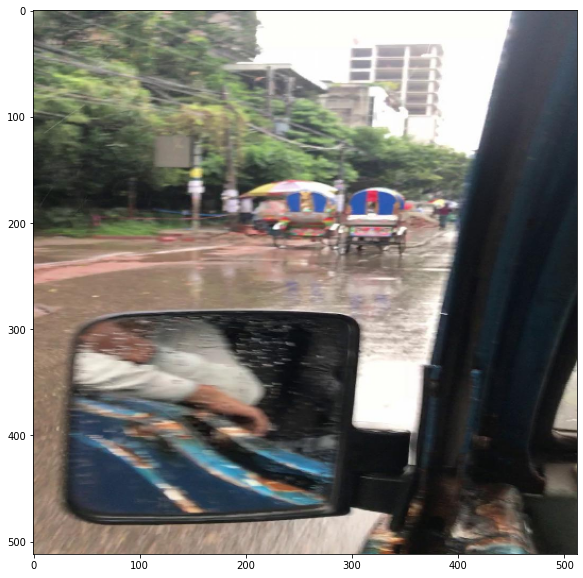

/content/gdrive/My Drive/Dhaka/images/test/Shykat_5_ (40)_jpg.rf.2cfa911b9a9f1c9c835fd1ba06211321.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[473.6469, 541.2593, 500.2233, 593.5417]], device='cuda:0')), scores: tensor([0.5791], device='cuda:0'), pred_classes: tensor([4], device='cuda:0')])}


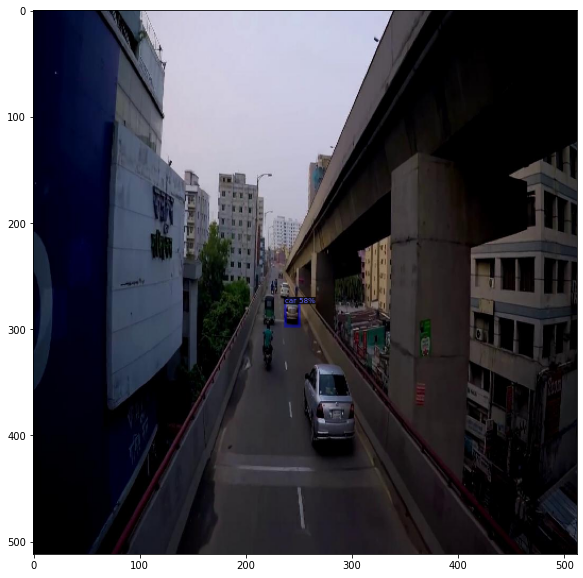

/content/gdrive/My Drive/Dhaka/images/test/Shykat_5_ (7)_jpg.rf.500a7fb1705b9525167bb53eac898070.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[387.8695, 675.9571, 445.2697, 751.3829]], device='cuda:0')), scores: tensor([0.6403], device='cuda:0'), pred_classes: tensor([4], device='cuda:0')])}


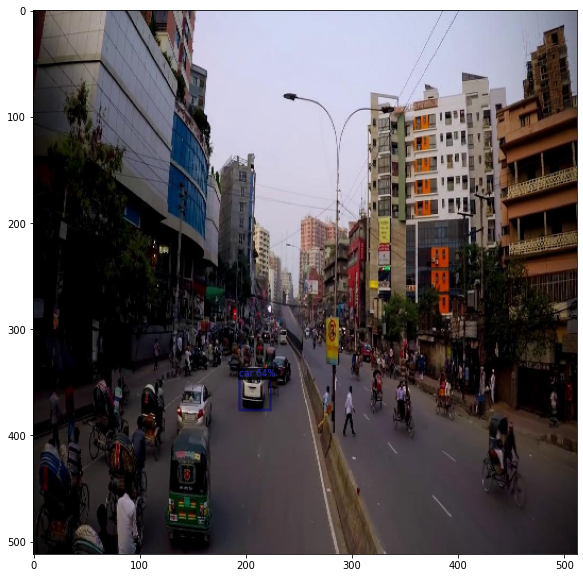

/content/gdrive/My Drive/Dhaka/images/test/Shykat_5_ (88)_jpg.rf.4f7ef389d50458e557a57482e5b42b55.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


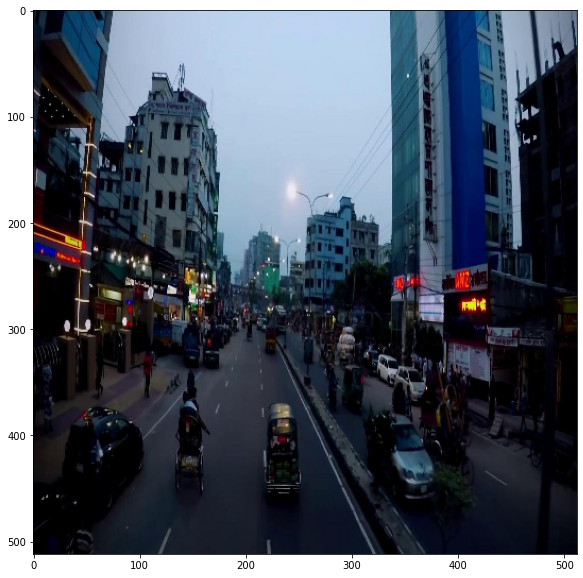

/content/gdrive/My Drive/Dhaka/images/test/Shykat_02_014_jpg.rf.64ea0faf233dfae6ff7fc80e3350c906.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[642.7821, 600.3268, 699.6986, 669.6391]], device='cuda:0')), scores: tensor([0.6001], device='cuda:0'), pred_classes: tensor([4], device='cuda:0')])}


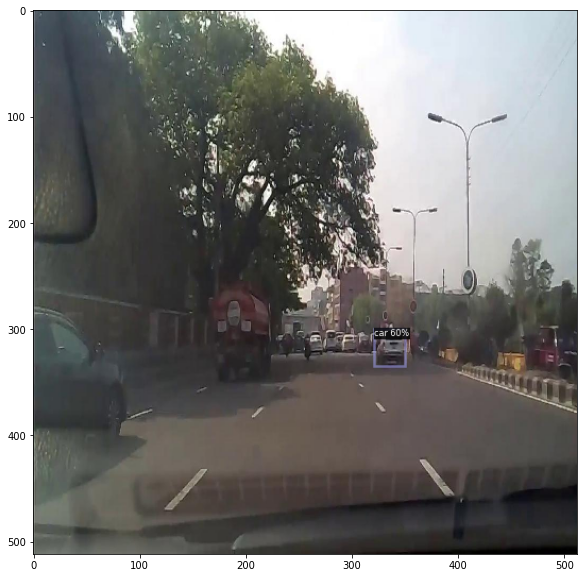

/content/gdrive/My Drive/Dhaka/images/test/Shykat_5_ (21)_jpg.rf.11b91aca443437c99fed5e1d5d0285e5.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[483.3553, 600.5128, 526.2744, 652.1103]], device='cuda:0')), scores: tensor([0.7012], device='cuda:0'), pred_classes: tensor([4], device='cuda:0')])}


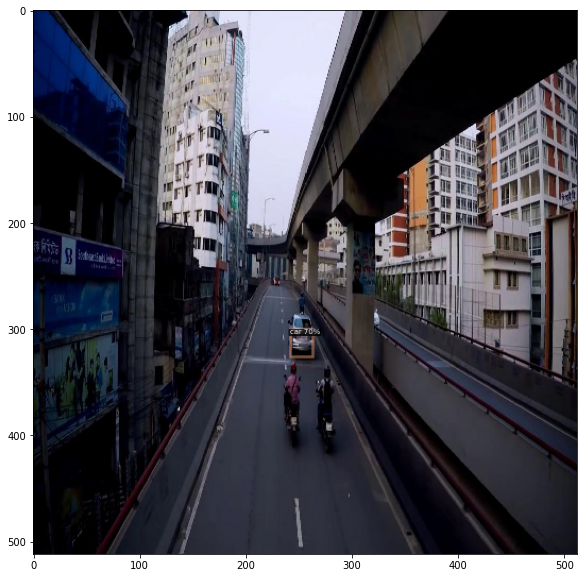

/content/gdrive/My Drive/Dhaka/images/test/sabiha(300)_jpg.rf.5c95cec0762afb2c66e8e438911788b4.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[578.6467, 646.5563, 646.3842, 717.2307]], device='cuda:0')), scores: tensor([0.6532], device='cuda:0'), pred_classes: tensor([4], device='cuda:0')])}


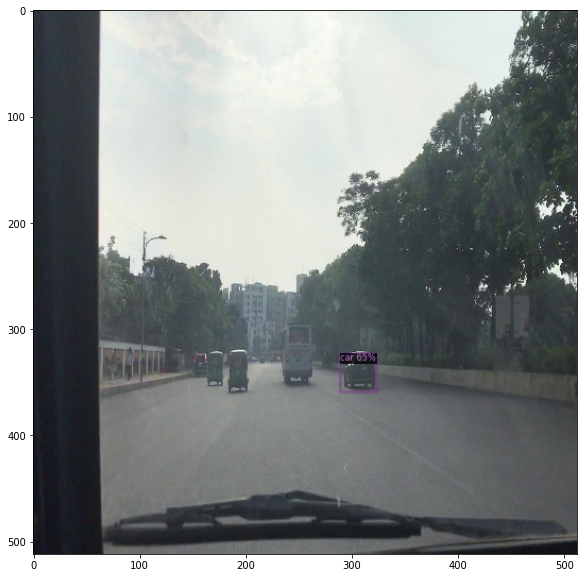

/content/gdrive/My Drive/Dhaka/images/test/sabiha(263)_jpg.rf.03d0db5aa784c807bf9533db22290b6d.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


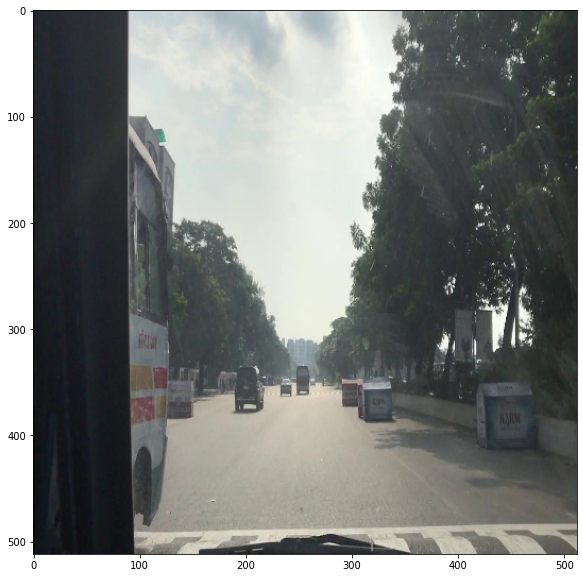

/content/gdrive/My Drive/Dhaka/images/test/Shykat_03_015_jpg.rf.76648269ab211cc7face25e4a2f4625a.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


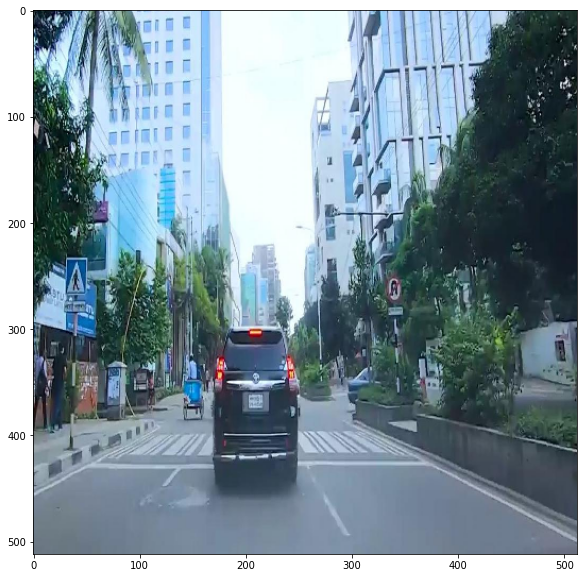

/content/gdrive/My Drive/Dhaka/images/test/sabiha(140)_jpg.rf.45544a9ecca6995d272cdeaf29d11868.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


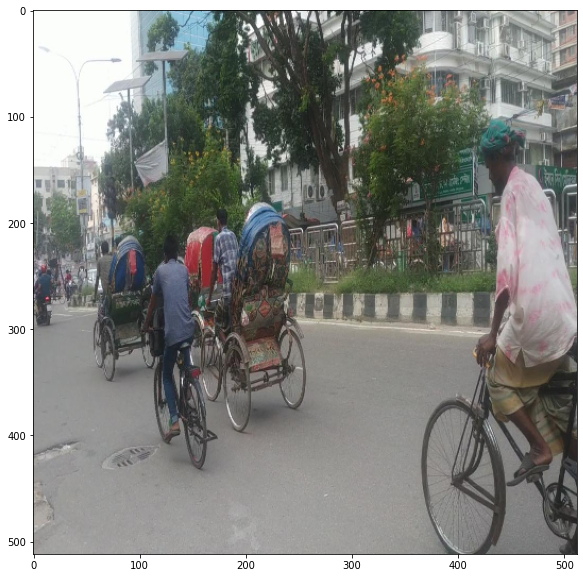

/content/gdrive/My Drive/Dhaka/images/test/Shykat_5_ (12)_jpg.rf.4b9516dca1e555b7ef52a3e0ae3d3000.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


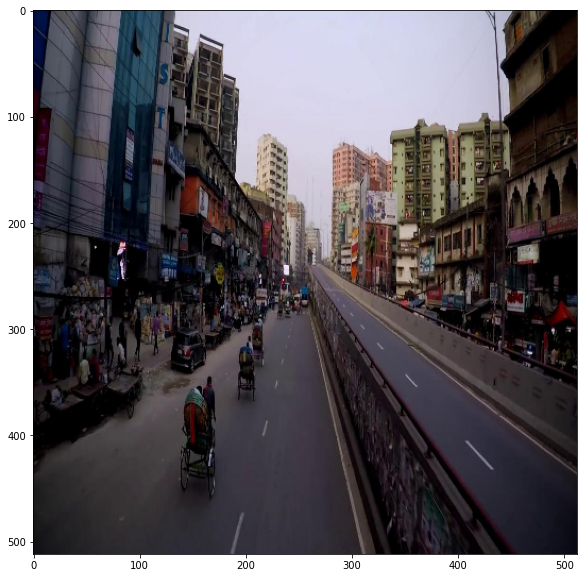

/content/gdrive/My Drive/Dhaka/images/test/Sabiha_(49)_jpg.rf.593057a93ba74e1957eda6ba05f3324f.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


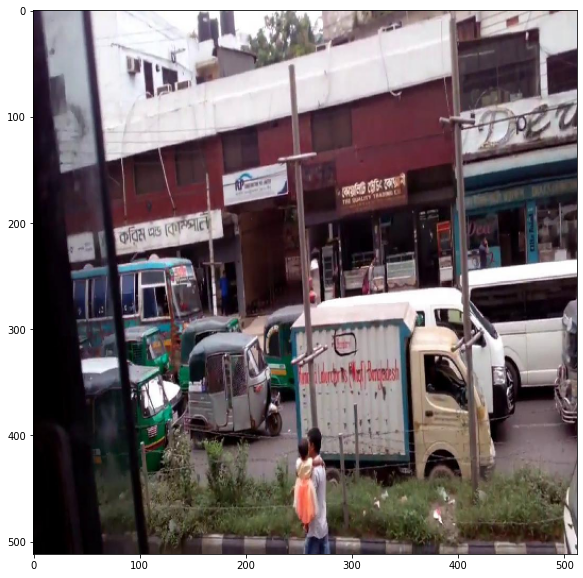

/content/gdrive/My Drive/Dhaka/images/test/sabiha(183)_jpg.rf.04825ace5ad87eb658677d035bc200f8.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


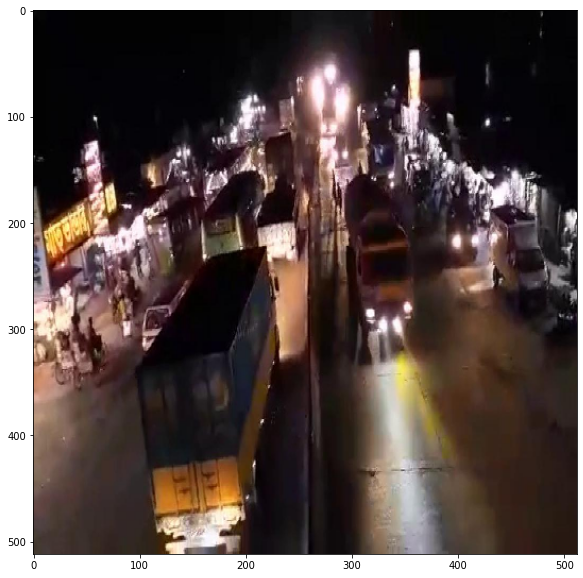

/content/gdrive/My Drive/Dhaka/images/test/Shykat_4_ (34)_jpg.rf.1bf1d076b872c4f2834b4bcc8f9feec9.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


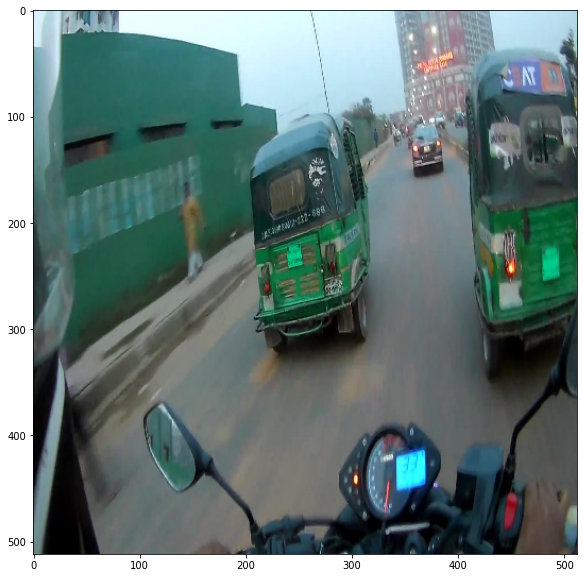

/content/gdrive/My Drive/Dhaka/images/test/sabiha(202)_jpg.rf.1fa2edf1c1750735ec6acd777c799665.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


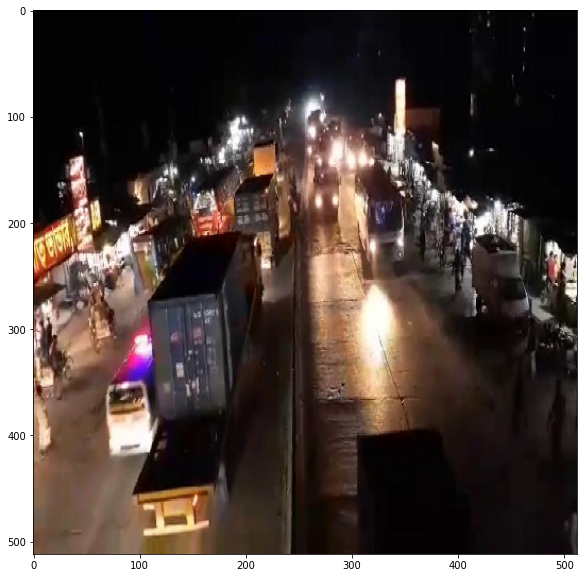

/content/gdrive/My Drive/Dhaka/images/test/sabiha(127)_jpg.rf.32940a3da193ce5fa8187b027c406bcd.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[179.2829, 521.0660, 237.4654, 582.3662]], device='cuda:0')), scores: tensor([0.8531], device='cuda:0'), pred_classes: tensor([4], device='cuda:0')])}


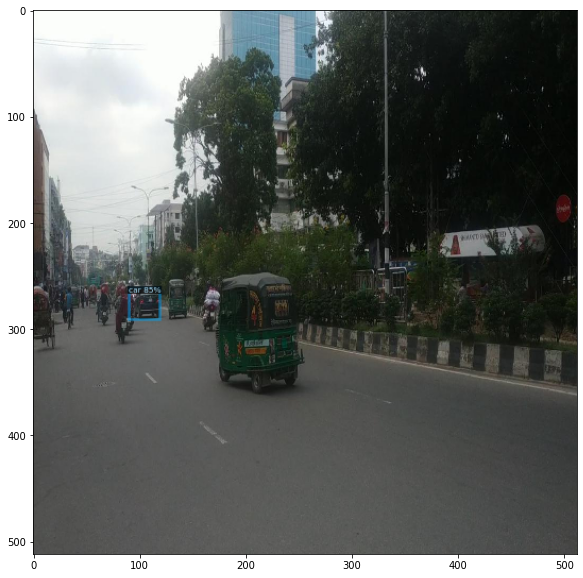

/content/gdrive/My Drive/Dhaka/images/test/Sabiha_(18)_jpg.rf.2d99bbe6021834328af969e718d6b5df.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


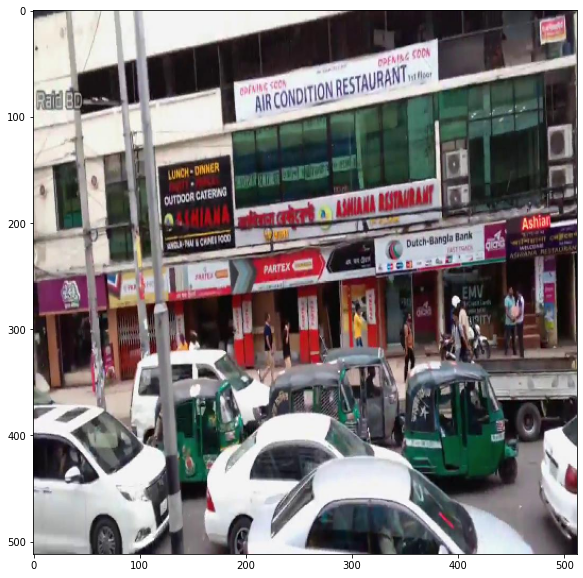

/content/gdrive/My Drive/Dhaka/images/test/Shykat_5_ (59)_jpg.rf.37848c9699fd6e1f13c02bb9cc0a73e6.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


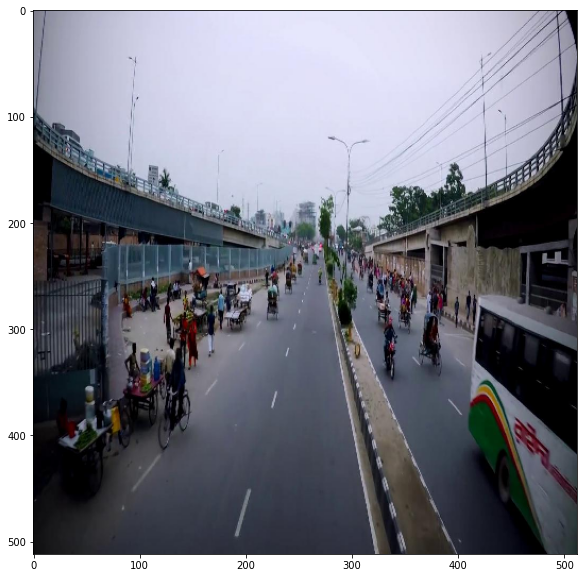

/content/gdrive/My Drive/Dhaka/images/test/sabiha(205)_jpg.rf.51c9cd5ce68e9776f8e971af1b114738.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


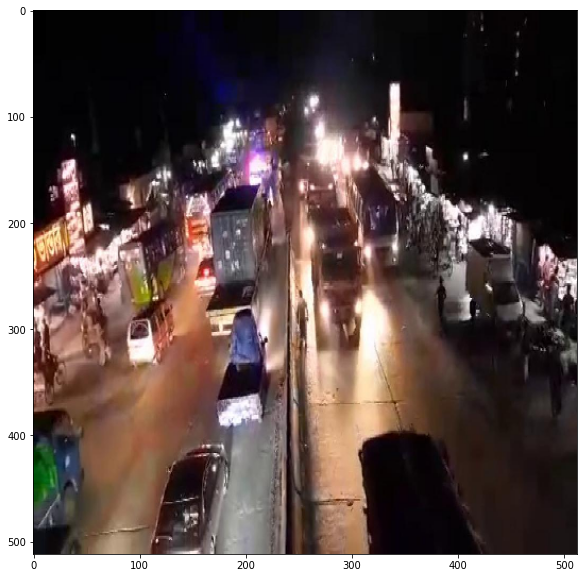

/content/gdrive/My Drive/Dhaka/images/test/sabiha(303)_jpg.rf.66506cde12b3e190df17bc28c0fcd878.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[511.0148, 675.9799, 534.5140, 716.6973]], device='cuda:0')), scores: tensor([0.6581], device='cuda:0'), pred_classes: tensor([4], device='cuda:0')])}


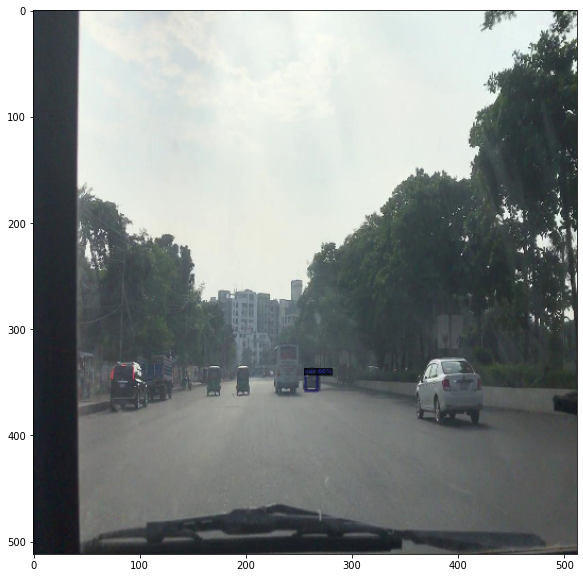

/content/gdrive/My Drive/Dhaka/images/test/sabiha(167)_jpg.rf.64c558bc072f848330231c8c89fd0bf6.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


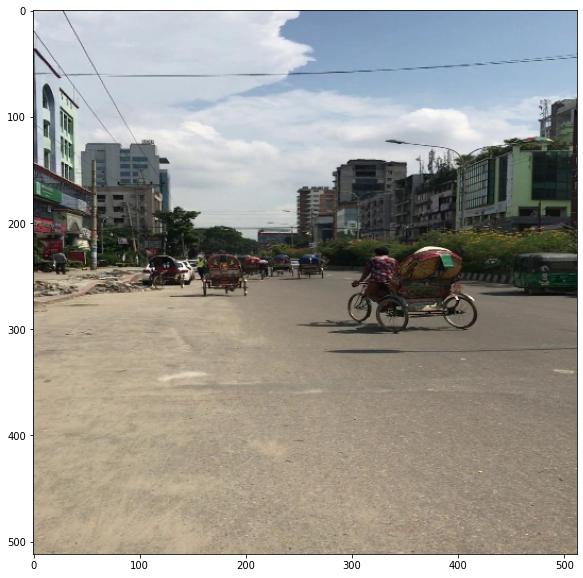

/content/gdrive/My Drive/Dhaka/images/test/Sabiha_(51)_jpg.rf.079d042735b2e15f2e6a388ec482fe5a.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


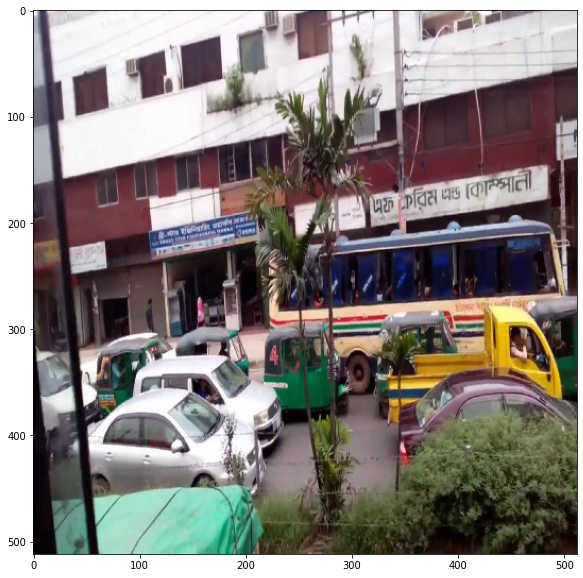

/content/gdrive/My Drive/Dhaka/images/test/sabiha(279)_jpg.rf.1b73844e91805f851f80e116a2cdd436.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


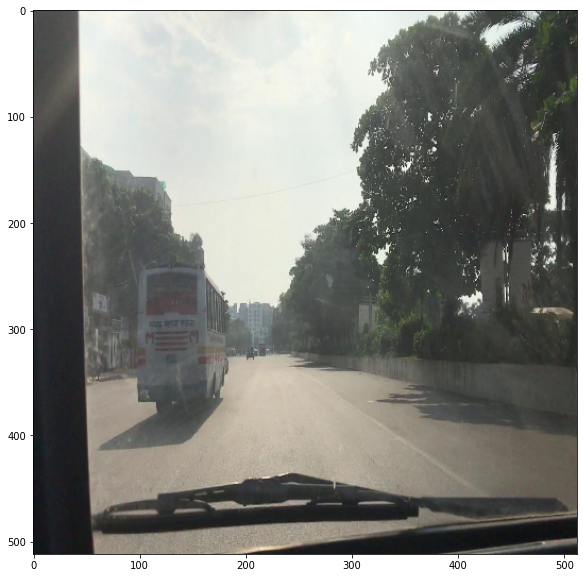

/content/gdrive/My Drive/Dhaka/images/test/sabiha(247)_jpg.rf.1035a27c9dcf576335244bea53ca8b47.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[107.1899, 173.7992, 142.2098, 228.7592]], device='cuda:0')), scores: tensor([0.5102], device='cuda:0'), pred_classes: tensor([9], device='cuda:0')])}


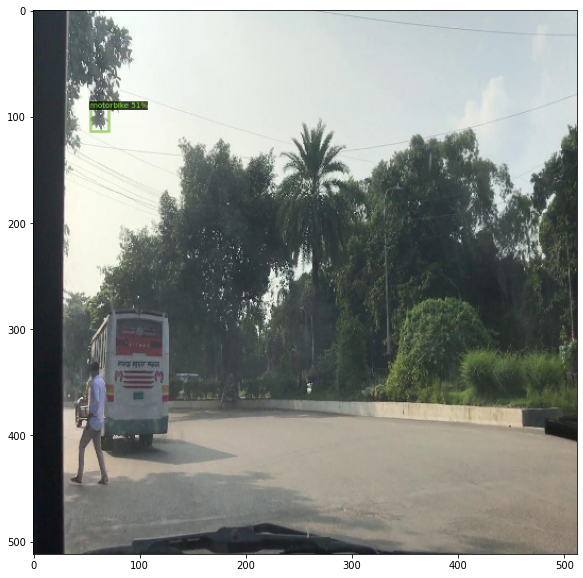

/content/gdrive/My Drive/Dhaka/images/test/sabiha(245)_jpg.rf.153039c6a25aa1779a7717a74e78dcd6.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


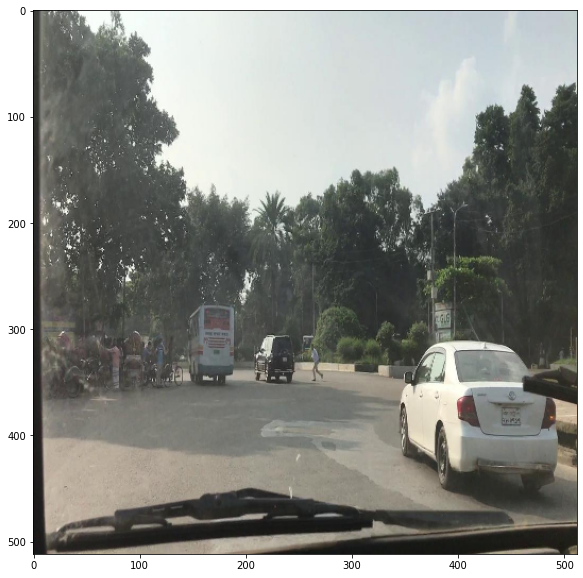

/content/gdrive/My Drive/Dhaka/images/test/sabiha(184)_jpg.rf.225bfbf43d2208eecc501bf0ad106f5b.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


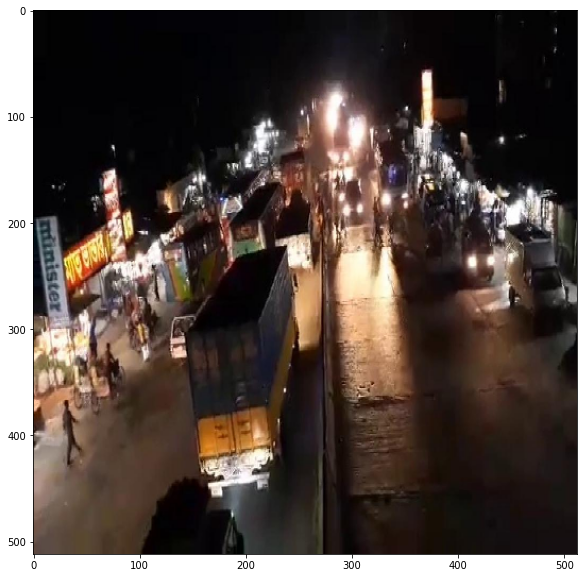

/content/gdrive/My Drive/Dhaka/images/test/Shykat_4_ (36)_jpg.rf.009b7a209c900850c728b8b11a7d7477.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


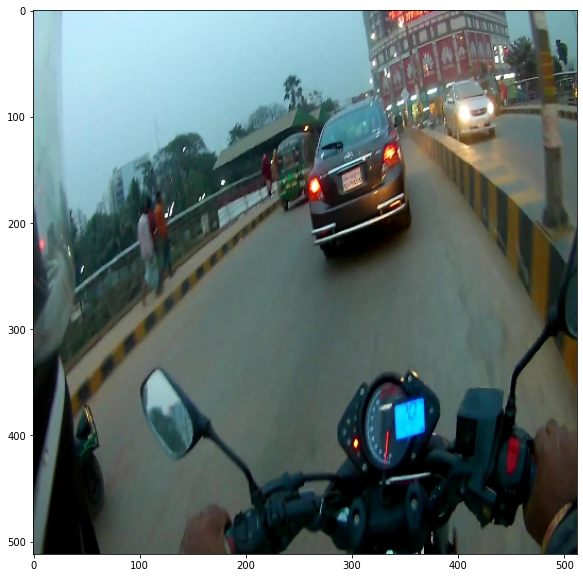

/content/gdrive/My Drive/Dhaka/images/test/Shykat_5_ (61)_jpg.rf.460f3cb61fe54110a1f7062d1f5b2d09.jpg
{'instances': Instances(num_instances=0, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([], device='cuda:0', size=(0, 4))), scores: tensor([], device='cuda:0'), pred_classes: tensor([], device='cuda:0', dtype=torch.int64)])}


In [ ]:

import glob
import os
path = glob.glob('/content/gdrive/My Drive/Dhaka/images/test/*')
a=[]
df = pd.DataFrame(columns=["image_id", ""]) 
for filename in path:
    print(filename)
    im = cv2.imread(filename)
    outputs = predictor(im)
    filename = filename.split("/")
    filename = filename[7]

    print(outputs)
    v = Visualizer(im[:, :, ::-1], metadata=car_metadata, scale=0.5)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()    

        
        

In [ ]:
experiment_metrics = load_json_arr('/content/gdrive/MyDrive/Dhaka/output/metrics.json')
print(experiment_metrics)

In [ ]:
import numpy as np
from shapely.geometry import Polygon,Point
import matplotlib.pyplot as plt
import shapely
import cv2 as cv
import os
import gc


def evaluation(ground,pred,iou_value):
  """
  ground= array of ground-truth contours.
  preds = array of predicted contours.
  iou_value= iou treshold for TP and otherwise.
  """
  truth=np.squeeze(ground)
  preds=np.squeeze(pred)
  #we will use this function to check iou less than threshold
  def CheckLess(list1,val):
    return(all(x<=val for x in list1))

  # Using predicted output as the reference
  prob1=[]
  for i in range(len(preds)):
      f1=preds[i]
      # define a Shapely polygone for prediction i
      f1=shapely.geometry.Polygon(f1)
      # determine the radius
      f1_radius=np.sqrt((f1.area)/np.pi)
      #buffer the polygon fromt the centroid
      f1_buffered=shapely.geometry.Point(f1.centroid).buffer(f1_radius*500)
      cont=[]
      for i in range(len(truth)):
        ff=shapely.geometry.Polygon(np.squeeze(truth[i]))
        if f1_buffered.contains(ff)== True:
          iou=(ff.intersection(f1).area)/(ff.union(f1).area)  
       
          cont.append((iou))

      prob1.append(cont)

  fp=0

  for t in prob1:
    if CheckLess(t,iou_value)==True:
      fp=fp+1
    
  prob2=[]
  #loop through each groun truth instance 
  for i in range(len(truth)):
      f1=truth[i]
      f1=shapely.geometry.Polygon(f1)
      #find radius
      f1_radius=np.sqrt((f1.area)/np.pi)
      #buffer the polygon from the centroid
      f1_buffered=shapely.geometry.Point(f1.centroid).buffer(f1_radius*500)
      cont=[]
      # merge up the ground truth instance against prediction
      # to determine the IoU
      for i in range(len(preds)):
        ff=shapely.geometry.Polygon(np.squeeze(preds[i]))
        if f1_buffered.contains(ff)== True:
          #calculate IoU
          iou=(ff.intersection(f1).area)/(ff.union(f1).area)
          cont.append((iou))
      # probability of a given prediction to be contained in a
      # ground truth instance
      prob2.append(cont)
  fn=0
  tp=0
  for t in prob2:
    if np.sum(t)==0:
      fn=fn+1
    elif CheckLess(t,iou_value)==False:
      tp=tp+1
  
  #lets add this section just to print the results
  print("TP:",tp,"\t FP:",fp,"\t FN:",fn,"\t GT:",truth.shape[0])
  precision=round(tp/(tp+fp),3) 
  recall=round(tp/(tp+fn),3)
  f1= round(2*((precision*recall)/(precision+recall)),3)
  print("Precall:",precision,"\t Recall:",recall, "\t F1 score:",f1)
  
  return tp,fp,fn,precision,recall,f1




In [ ]:
detectron2.evaluation.COCOEvaluator('/content/gdrive/MyDrive/Dhaka/images/test', cfg, False, output_dir="/content/gdrive/MyDrive/Dhaka/output" )

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator( 'images_train' , ("bbox"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "images_train")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [01/18 11:11:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
0        images/train/Dipto_ 111.jpg
1        images/train/Dipto_ 111.jpg
2        images/train/Dipto_ 111.jpg
3        images/train/Dipto_ 111.jpg
4        images/train/Dipto_ 111.jpg
                    ...             
13856     images/train/Dipto_ 42.jpg
13857     images/train/Dipto_ 42.jpg
13858     images/train/Dipto_ 42.jpg
13859     images/train/Dipto_ 43.jpg
13860     images/train/Dipto_ 43.jpg
Name: filename, Length: 13861, dtype: object
0        18
1        18
2        18
3        18
4        17
         ..
13856     3
13857    17
13858     3
13859     9
13860     9
Name: class_int, Length: 13861, dtype: int64
images/train/Dipto_ 111.jpg
images/train/Dipto_ 112.jpg
images/train/Dipto_ 113.jpg
images/train/Dipto_ 114.jpg
images/train/Dipto_ 115.jpg
images/train/Dipto_ 116.jpg
images/train/Dipto_ 117.jpg
images/train/Dipto

KeyError: ignored